## **Restore from Google Drive**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [14]:
!cp /content/drive/MyDrive/ECE-653/0421.zip . && unzip 0421.zip && rm 0421.zip

Archive:  0421.zip
  inflating: best_filter_1.npy       
  inflating: best_filter_2.npy       


In [2]:
!cp /content/drive/MyDrive/ECE-653/best_traffic_sign_model.pth .

In [ ]:
!cp /content/drive/MyDrive/ECE-653/adv_samples_for_experiment.zip . && unzip adv_samples_for_experiment.zip && rm adv_samples_for_experiment.zip

## **Import packages**

In [4]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.transforms as transforms

from PIL import Image
from IPython.display import display
from google.colab.patches import cv2_imshow
from tqdm import tqdm

import os
import time
import random

## **Set to use CUDA**

In [5]:
# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cpu


## **Class Mapping**

In [6]:

class_to_idx = {
  'Speed Limit 10': 0,
  'Speed Limit 20': 1,
  'Speed Limit 30': 2,
  'Speed Limit 40': 3,
  'Speed Limit 50': 4,
  'Speed Limit 60': 5,
  'Speed Limit 70': 6,
  'Speed Limit 80': 7,
  'Speed Limit 90': 8,
  'Speed Limit 100': 9,
  'Speed Limit 110': 10,
  'Speed Limit 120': 11,
  'Stop': 12
}

class_names = {
    0: 'Speed Limit 10',
    1: 'Speed Limit 20',
    2: 'Speed Limit 30',
    3: 'Speed Limit 40',
    4: 'Speed Limit 50',
    5: 'Speed Limit 60',
    6: 'Speed Limit 70',
    7: 'Speed Limit 80',
    8: 'Speed Limit 90',
    9: 'Speed Limit 100',
    10: 'Speed Limit 110',
    11: 'Speed Limit 120',
    12: 'Stop'
}

## **Define our classifier**

In [7]:
IMAGE_SIZE = 64

class SimpleTrafficSignNet(nn.Module):
    def __init__(self, num_classes=13):
        super(SimpleTrafficSignNet, self).__init__()

        # Layer definitions
        self.conv1 = nn.Conv2d(3, IMAGE_SIZE, kernel_size=5, padding=2)
        self.dropout1 = nn.Dropout(0.1)
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv2 = nn.Conv2d(IMAGE_SIZE, IMAGE_SIZE*2, kernel_size=5, padding=2)
        self.dropout2 = nn.Dropout(0.2)

        self.conv3 = nn.Conv2d(IMAGE_SIZE*2, IMAGE_SIZE*4, kernel_size=5, padding=2)
        self.dropout3 = nn.Dropout(0.3)

        # This is the key part - we need separate pooling layers with specific sizes
        # to match the Keras model architecture exactly
        self.pool4 = nn.MaxPool2d(kernel_size=8, stride=8)
        self.pool5 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.dropout4 = nn.Dropout(0.5)

        self.fc1 = nn.Linear(28672, 1024)
        self.fc2 = nn.Linear(1024, num_classes)

    def forward(self, x):
        # Conv1 path
        x1 = self.conv1(x)
        x1 = F.relu(x1)
        x1 = self.dropout1(x1)
        x1_pooled = self.pool(x1)

        # Conv2 path
        x2 = self.conv2(x1_pooled)
        x2 = F.relu(x2)
        x2 = self.dropout2(x2)
        x2_pooled = self.pool(x2)

        # Conv3 path
        x3 = self.conv3(x2_pooled)
        x3 = F.relu(x3)
        x3 = self.dropout3(x3)
        x3_pooled = self.pool(x3)

        # Multiscale pooling paths (matching Keras exactly)
        # Path 1: pool4 directly on conv1 output (after dropout)
        path1 = self.pool4(x1)

        # Path 2: pool5 on the output of pool2
        path2 = self.pool5(x2_pooled)

        # Path 3: already at the right size from pool3
        path3 = x3_pooled

        # Flatten and concatenate
        flat1 = torch.flatten(path1, 1)
        flat2 = torch.flatten(path2, 1)
        flat3 = torch.flatten(path3, 1)

        merged = torch.cat([flat1, flat2, flat3], dim=1)

        # Dense layers
        dense1 = self.fc1(merged)
        dense1 = F.relu(dense1)
        dense1 = self.dropout4(dense1)

        # Output layer (logits, no activation)
        output = self.fc2(dense1)         # num_classes

        return output

## **Define Inference**

In [8]:
def infer(model, cv_image):
    # Set model to evaluation mode
    cv2_image_rgb = cv2.cvtColor(cv_image, cv2.COLOR_BGR2RGB)
    image = Image.fromarray(cv2_image_rgb)
    transform = transforms.ToTensor()

    image_tensor = transform(image)
    image_tensor = image_tensor.permute(1, 2, 0)

    image_tensor = image_tensor.to(device)
    model = model.to(device)

    return predict(model, image_tensor)

# This predict function will be also used by adversarial attacks!
def predict(model, x_in):
    device = next(model.parameters()).device
    model.eval()

    with torch.no_grad():
        # Get current image dimensions
        h, w, c = x_in.shape

        # Convert numpy to tensor and add batch dimension
        x_tensor = x_in.clone().detach().permute(2, 0, 1).unsqueeze(0).to(device)
        #x_tensor = torch.tensor(x_in, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0).to(device)

        if torch.any(x_tensor > 1.0):
            x_tensor = x_tensor / 255.0

        # Resize to model input size if needed
        if h != IMAGE_SIZE or w != IMAGE_SIZE:
            x_tensor = F.interpolate(x_tensor, size=(IMAGE_SIZE, IMAGE_SIZE), mode='bilinear', align_corners=False)

        outputs = model(x_tensor)

        probabilities = torch.nn.functional.softmax(outputs, dim=1)
        prediction = outputs.argmax(dim=1).cpu().numpy()[0]


    return prediction, probabilities.squeeze().cpu().numpy()

def predict_class_only(model, x_in):
    prediction, _ = predict(model, x_in)
    return prediction

# Function to display prediction results
def display_prediction(predicted_class, probabilities):
    """
    Display the prediction results

    Args:
        predicted_class: Index of the predicted class
        probabilities: Probabilities for each class
    """
    print(f"Predicted class: {class_names[predicted_class]}")
    print(f"Confidence: {probabilities[predicted_class]*100:.2f}%")

    # Display top 3 predictions
    top3_indices = np.argsort(probabilities)[-3:][::-1]

    plt.figure(figsize=(10, 5))
    plt.barh([class_names[i] for i in top3_indices],
             [probabilities[i] for i in top3_indices])
    plt.xlabel('Probability')
    plt.title('Top 3 Predictions')
    plt.tight_layout()
    plt.show()

def perform_inference(model, cv_image, should_crop=False, display_pred=False):
    if should_crop:
      cv_image = crop_with_custom_model_cv2(cv_image)
      if cv_image is None:
          print("Nothing detected.")
          return None, None

    # Perform inference
    predicted_class, probabilities = infer(model, cv_image)

    if display_pred:
      display_prediction(predicted_class, probabilities)

    return predicted_class, probabilities

## **Load Model**

In [9]:
def load_model(model_path, num_classes=13):
    model = SimpleTrafficSignNet(num_classes=num_classes)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.eval()
    return model

model = load_model('best_traffic_sign_model.pth')

## **Define Paths**

In [10]:
ADV_SAMPLES_PATH = os.path.join('adv_samples_for_experiment')

## **Simulate Paper Print**

In [11]:
def simulate_print(img, dpi=300, paper_type='glossy'):
    """
    Simulate how an image would look when printed on paper.

    Parameters:
    - img: cv2 image
    - output_path: Path to save the simulated output
    - dpi: Dots per inch for the simulated print (default 300)
    - paper_type: Type of paper ('glossy', 'matte', 'newspaper')

    Returns:
    - Simulated printed image
    """

    # Step 1: Resize based on DPI
    # Calculate scaling factor based on DPI
    # For example, 144 DPI (screen) to print DPI (e.g., 300)
    scale_factor = 144 / dpi
    if scale_factor != 1:
        new_width = int(img.shape[1] * scale_factor)
        new_height = int(img.shape[0] * scale_factor)
        img = cv2.resize(img, (new_width, new_height), interpolation=cv2.INTER_AREA)
        # Resize back to original dimensions to simulate the print resolution
        img = cv2.resize(img, (img.shape[1], img.shape[0]), interpolation=cv2.INTER_LINEAR)

    # Step 2: Apply color profile adjustments (CMYK simulation)
    # Convert to float32 for processing
    img_float = img.astype(np.float32) / 255.0

    # Apply color adjustments based on paper type
    if paper_type == 'glossy':
        # Glossy paper - vibrant but slightly darkened
        contrast = 1.1
        brightness = -0.05
        saturation = 1.05
    elif paper_type == 'matte':
        # Matte paper - less contrast, slightly desaturated
        contrast = 0.90
        brightness = 0.0
        saturation = 0.9
    elif paper_type == 'newspaper':
        # Newspaper - low contrast, desaturated
        contrast = 0.8
        brightness = 0.1
        saturation = 0.7
    else:
        # Default
        contrast = 1.0
        brightness = 0.0
        saturation = 1.0

    # Apply contrast and brightness
    img_float = img_float * contrast + brightness
    img_float = np.clip(img_float, 0, 1)

    # Apply saturation adjustment
    hsv = cv2.cvtColor(img_float, cv2.COLOR_BGR2HSV)
    hsv[:,:,1] = hsv[:,:,1] * saturation
    img_float = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

    # Step 3: Simulate ink spread/dot gain
    # Create a slight blur to simulate ink spreading on paper
    #kernel_size = max(1, int(300 / dpi))  # Adjust based on DPI
    #img_float = cv2.GaussianBlur(img_float, (kernel_size*2+1, kernel_size*2+1), 0.5)
    kernel_size = 2
    #img_float = cv2.GaussianBlur(img_float, (kernel_size*2+1, kernel_size*2+1), 0.5)
    img_float = cv2.GaussianBlur(img_float, (kernel_size*2+1, kernel_size*2+1), 0.5)
    img_float = cv2.medianBlur(img_float, 1)


    # Step 4: Add paper texture
    # Create a paper texture
    texture = np.ones_like(img_float)
    noise = np.random.normal(loc=0.95, scale=0.05, size=img_float.shape)
    texture = texture * noise
    texture = np.clip(texture, 0, 1)

    # Blend the image with the paper texture
    if paper_type == 'glossy':
        blend_factor = 0.03
    elif paper_type == 'newspaper':
        blend_factor = 0.15
    else:  # matte
        blend_factor = 0.08

    img_float = img_float * (1 - blend_factor) + texture * blend_factor

    # Convert back to uint8
    img_result = (img_float * 255).astype(np.uint8)

    return img_result


## **Simulate Image Resolution**

In [12]:

def simulate_camera(img,
                    target_resolution_ratio=0.5,
                    sensor_noise=0.02,
                    lens_quality=0.9,
                    sharpening=1.0,
                    brightness_preserve=1.0):  # Added brightness preservation parameter
    """
    Simulate taking a photo with a camera at different resolutions.

    Parameters:
    - image_path: cv2 image of high-res version
    - output_path: Path to save the simulated output (if None, just returns the image)
    - target_resolution: Tuple of (width, height) for the target camera resolution
    - sensor_noise: Amount of sensor noise to add (0.0 to 1.0)
    - lens_quality: Simulates lens quality (0.5 to 1.0, higher is better)
    - sharpening: Amount of camera sharpening to apply (0.0 to 2.0)
    - brightness_preserve: Factor to preserve original brightness (0.8 to 1.2)

    Returns:
    - Simulated camera image
    """

    original_height, original_width = img.shape[:2]
    target_resolution = (int(original_width * target_resolution_ratio), int(original_height * target_resolution_ratio))

    # Step 0: Random Rotation

    # Generate random angle between -3 and 3 degrees
    angle = random.uniform(-3, 3)

    # Get rotation matrix
    center = (original_width // 2, original_height // 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)

    # Calculate new bounding dimensions
    abs_cos = abs(rotation_matrix[0, 0])
    abs_sin = abs(rotation_matrix[0, 1])
    new_width = int(original_height * abs_sin + original_width * abs_cos)
    new_height = int(original_height * abs_cos + original_width * abs_sin)

    # Adjust the rotation matrix
    rotation_matrix[0, 2] += new_width / 2 - center[0]
    rotation_matrix[1, 2] += new_height / 2 - center[1]

    # Perform the rotation with white background (255,255,255)
    rotated = cv2.warpAffine(img, rotation_matrix, (new_width, new_height),
                            flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT,
                            borderValue=(255, 255, 255))

    # Crop to original size from the center to avoid white borders
    start_x = (new_width - original_width) // 2
    start_y = (new_height - original_height) // 2
    rotated = rotated[start_y:start_y+original_height, start_x:start_x+original_width]

    # If cropping caused any dimension issues, resize back to original
    if rotated.shape[:2] != (original_height, original_width):
        rotated = cv2.resize(rotated, (original_width, original_height))

    img = rotated

    # Step 1: Downsample to target resolution (simulating the camera sensor)
    downsampled = cv2.resize(img, target_resolution, interpolation=cv2.INTER_AREA)

    # Step 2: Apply lens blur based on lens quality
    # Lower quality lenses have more blur
    blur_amount = int(max(1, (1.0 - lens_quality) * 10))
    if blur_amount > 1:
        downsampled = cv2.GaussianBlur(downsampled, (blur_amount*2+1, blur_amount*2+1), 0)

    # Step 3: Add sensor noise
    if sensor_noise > 0:
        # Convert image to float32 for the addition operation
        float_img = downsampled.astype(np.float32)
        # Create noise with the same data type as the float image
        noise = np.random.normal(0, sensor_noise * 255, float_img.shape).astype(np.float32)
        # Add noise
        noisy_img = cv2.add(float_img, noise)
        # Convert back to uint8 with clipping
        noisy_img = np.clip(noisy_img, 0, 255).astype(np.uint8)
    else:
        noisy_img = downsampled

    # Step 4: Apply camera sharpening (most cameras do this in-camera)
    if sharpening > 0:
        # Create a sharpening kernel
        kernel = np.array([[-1, -1, -1],
                           [-1, 9 + sharpening, -1],
                           [-1, -1, -1]]) / (sharpening + 5)
        sharpened = cv2.filter2D(noisy_img, -1, kernel)
    else:
        sharpened = noisy_img

    # Step 5: Simulate color processing/enhancement that cameras do
    # With brightness preservation
    hsv = cv2.cvtColor(sharpened, cv2.COLOR_BGR2HSV).astype(np.float32)
    # Boost saturation slightly while preserving brightness
    hsv[:,:,1] = hsv[:,:,1] * 1.1  # Boost saturation slightly
    hsv[:,:,2] = hsv[:,:,2] * brightness_preserve  # Preserve brightness with adjustable factor
    hsv = np.clip(hsv, 0, 255).astype(np.uint8)
    color_processed = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

    # Step 6: JPEG compression artifacts (optional)
    # This simulates the camera's JPEG compression
    encode_param = [int(cv2.IMWRITE_JPEG_QUALITY), 90]
    _, encoded_img = cv2.imencode('.jpg', color_processed, encode_param)
    simulated_img = cv2.imdecode(encoded_img, cv2.IMREAD_COLOR)

    # Step 7: Resize back to original resolution for comparison
    # This simulates viewing the photo on a display
    result = cv2.resize(simulated_img, (original_width, original_height),
                        interpolation=cv2.INTER_LINEAR)

    return result

## **Apply Filter**

In [15]:
filter1 = np.load('best_filter_1.npy')
filter2 = np.load('best_filter_2.npy')

def apply_our_filter(img):
  original_mean = np.mean(sample_cv2_image, axis=(0, 1), keepdims=True)
  filtered_image = cv2.filter2D(sample_cv2_image, -1, filter1, borderType=cv2.BORDER_REFLECT)
  filtered_image = cv2.filter2D(filtered_image, -1, filter2, borderType=cv2.BORDER_REFLECT)
  filtered_mean = np.mean(filtered_image, axis=(0, 1), keepdims=True)
  brightness_ratio = original_mean / (filtered_mean + 1e-10)
  filtered_image = filtered_image * brightness_ratio
  filtered_image = np.clip(filtered_image, 0, 255).astype(np.uint8)
  return filtered_image


## **Show Result**

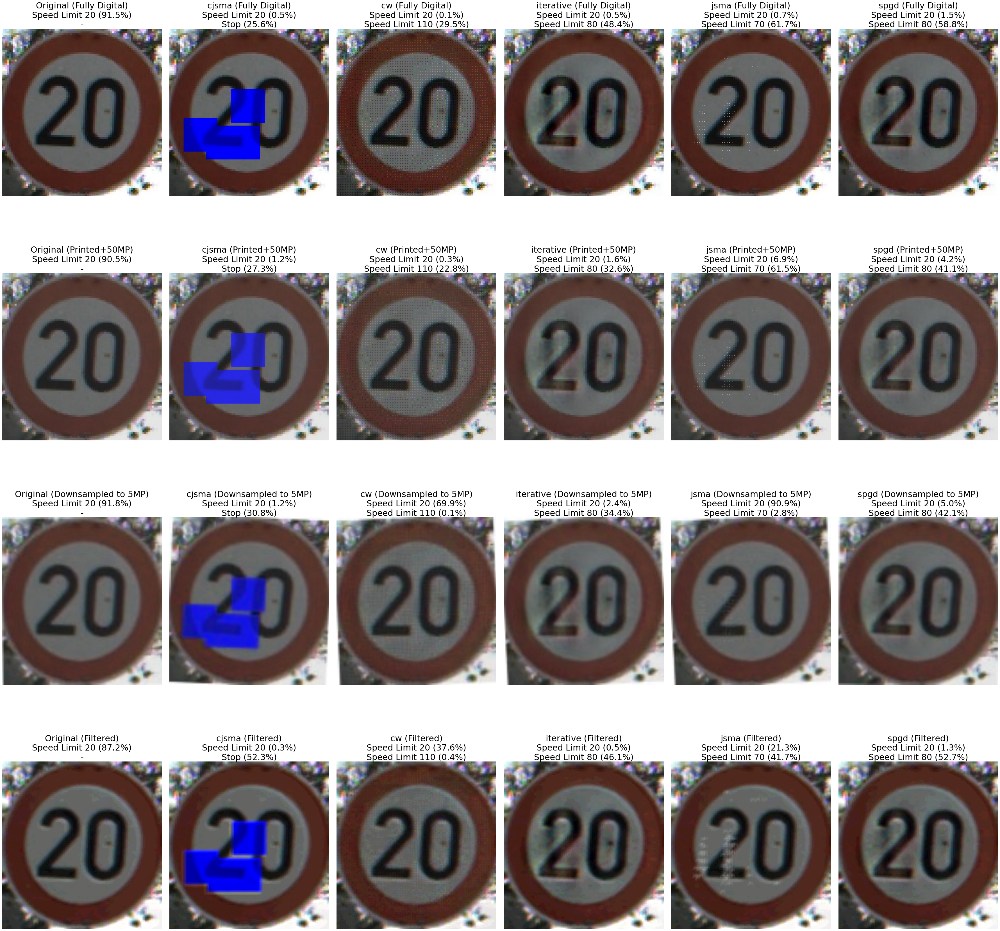

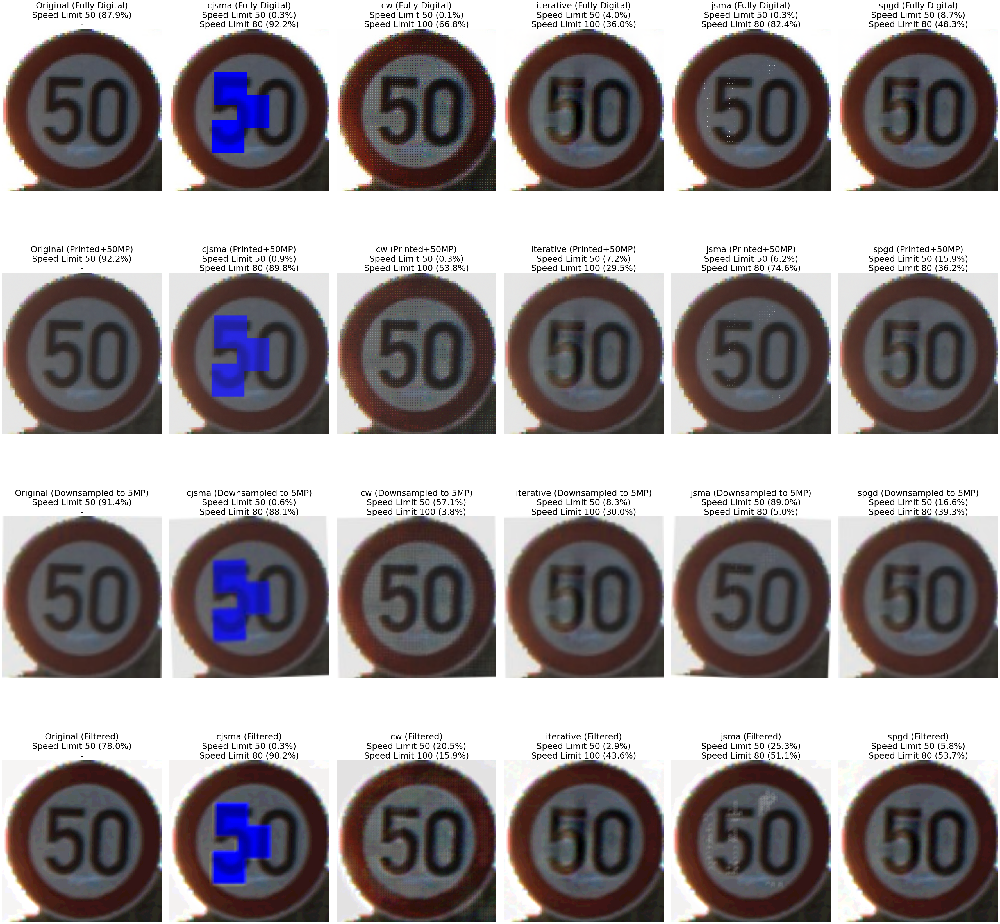

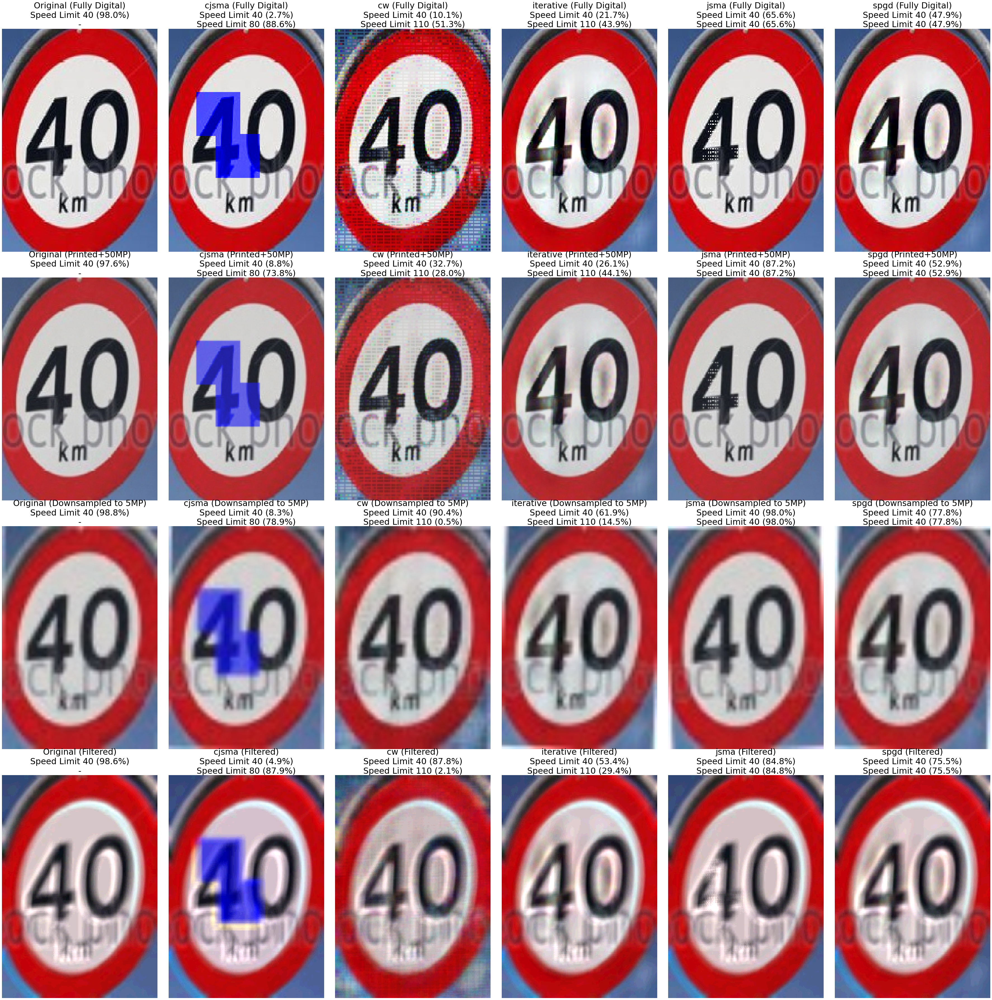

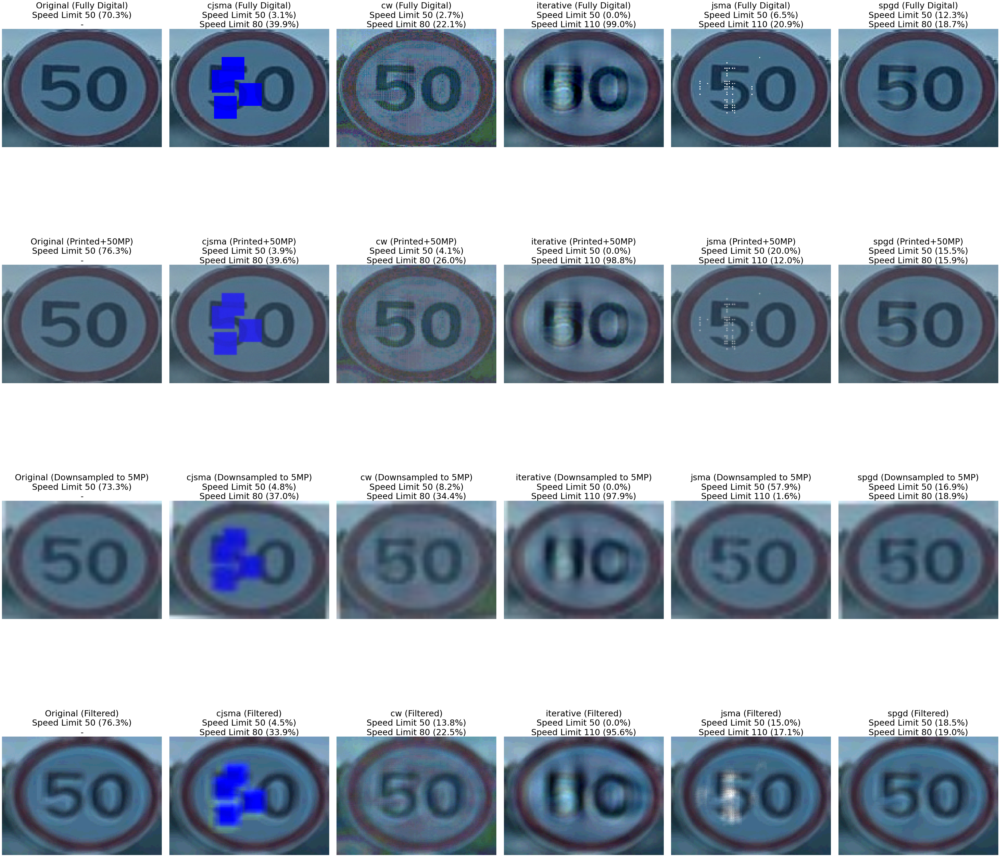

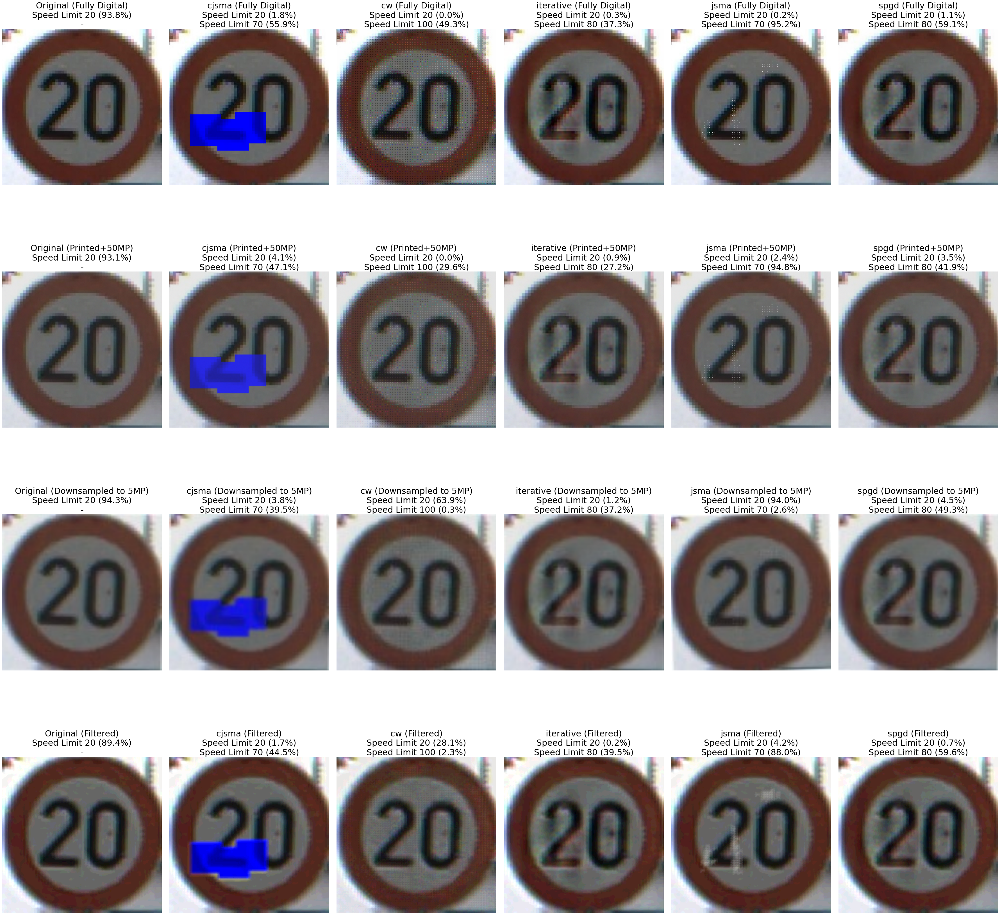

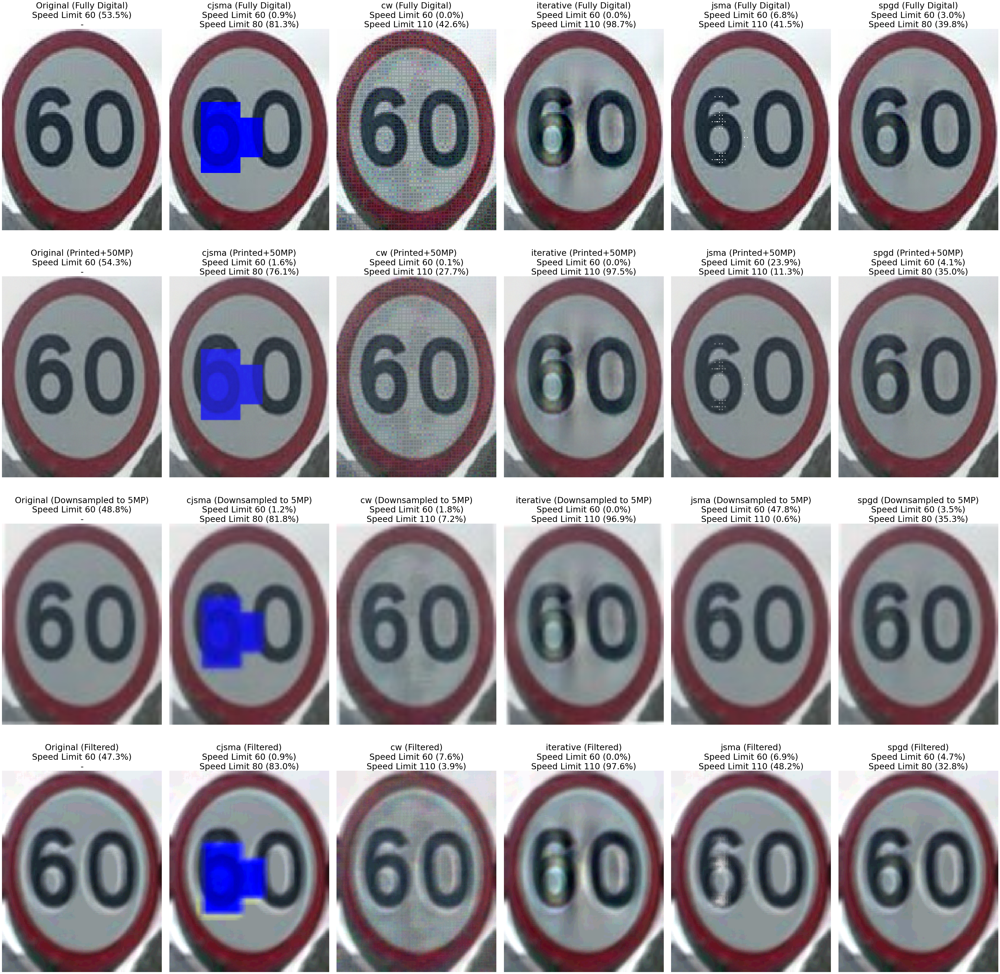

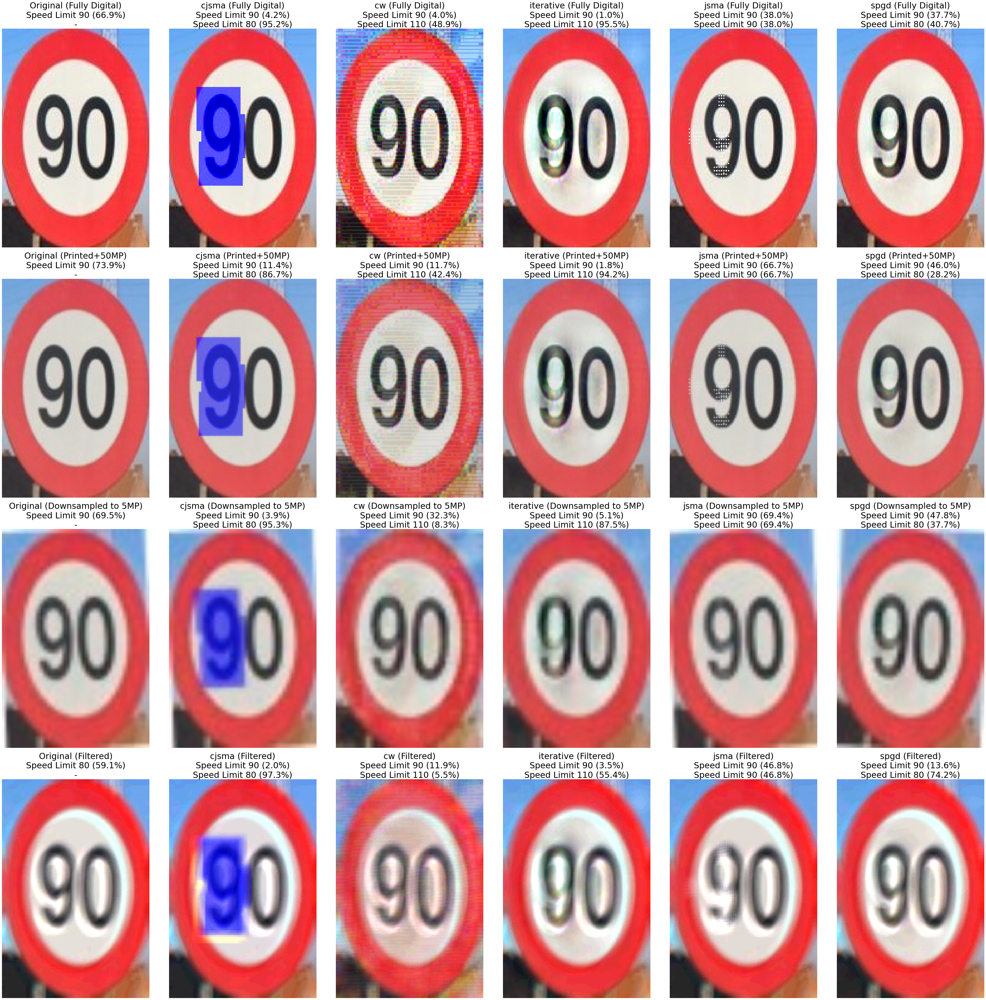

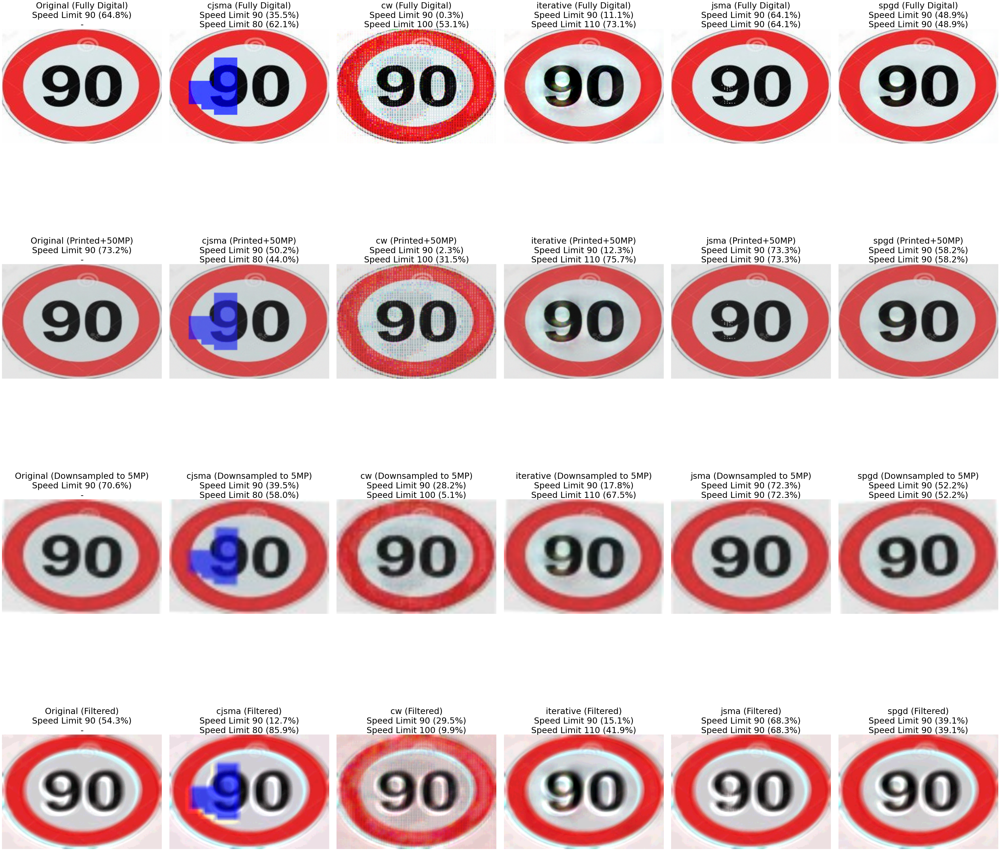

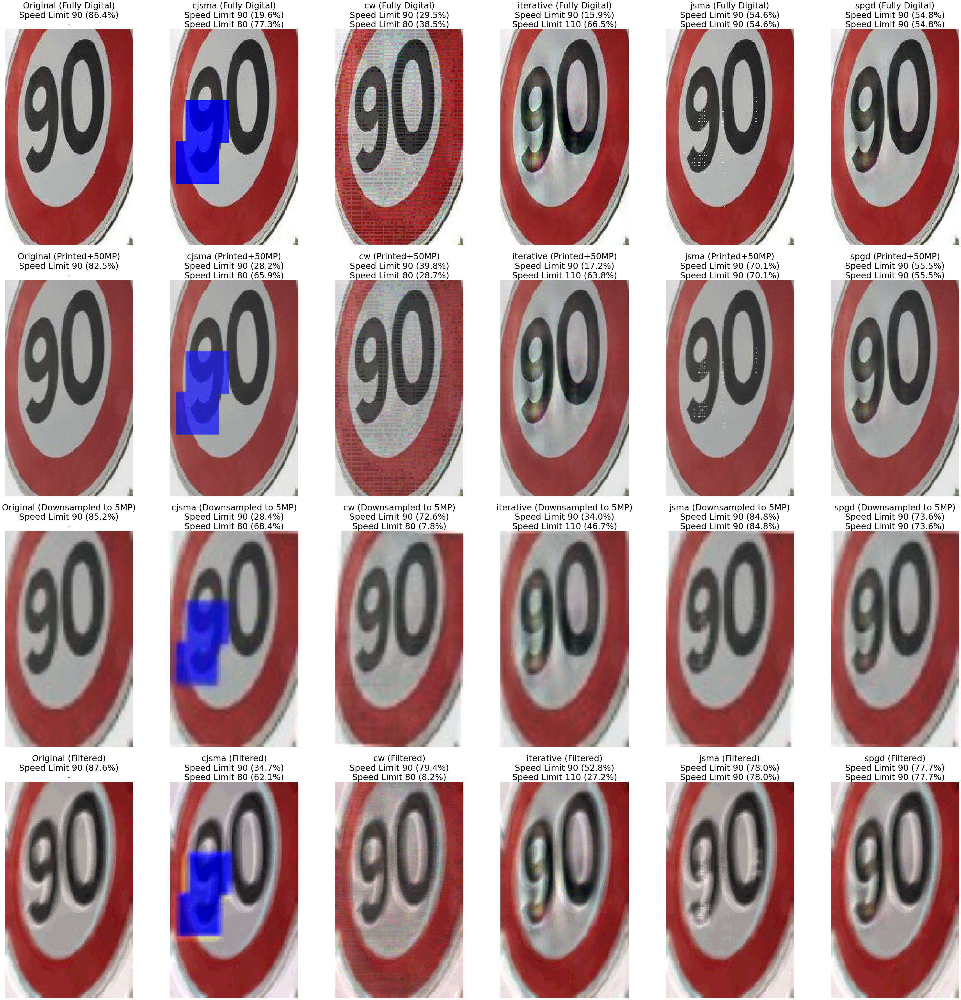

[PRINTED]
Attack Type: cjsma, Avg Original Label Receovery: 2.14%, Avg Perturbation Loss: -7.72%
Attack Type: jsma, Avg Original Label Receovery: 26.33%, Avg Perturbation Loss: -9.90%
Attack Type: cw, Avg Original Label Receovery: 5.33%, Avg Perturbation Loss: -10.53%
Attack Type: iterative, Avg Original Label Receovery: 1.66%, Avg Perturbation Loss: -5.99%
Attack Type: spgd, Avg Original Label Receovery: 4.99%, Avg Perturbation Loss: -8.53%
[PICTURED]
Attack Type: cjsma, Avg Original Label Receovery: 0.33%, Avg Perturbation Loss: -1.66%
Attack Type: jsma, Avg Original Label Receovery: 64.57%, Avg Perturbation Loss: -33.83%
Attack Type: cw, Avg Original Label Receovery: 48.82%, Avg Perturbation Loss: -35.38%
Attack Type: iterative, Avg Original Label Receovery: 5.46%, Avg Perturbation Loss: -9.22%
Attack Type: spgd, Avg Original Label Receovery: 10.12%, Avg Perturbation Loss: -6.58%
[FILTERED]
Attack Type: cjsma, Avg Original Label Receovery: -0.07%, Avg Perturbation Loss: -1.33%
Attac

In [17]:
plt.rcParams.update({'font.size': 25})

samples = [476, 304, 162, 114, 375, 183, 206, 464, 387, 39, 226, 465, 263, 344, 378, 473, 79, 326, 191, 73, 93, 437, 131, 439, 161, 12, 284, 144, 125, 121, 26, 309, 219, 35, 9, 19, 410, 409, 314, 209, 459, 176, 167, 468, 450, 216, 324, 360, 392]
samples_to_show = [476, 304, 162, 114, 375, 162, 114, 304, 183, 206, 464, 387]

printed_recovered_orig_label_pred_sum = {
    'cjsma': 0,
    'jsma': 0,
    'cw': 0,
    'iterative': 0,
    'spgd': 0
}

printed_reduced_adv_label_pred_sum = {
    'cjsma': 0,
    'jsma': 0,
    'cw': 0,
    'iterative': 0,
    'spgd': 0
}

pictured_recovered_orig_label_pred_sum = {
    'cjsma': 0,
    'jsma': 0,
    'cw': 0,
    'iterative': 0,
    'spgd': 0
}

pictured_reduced_adv_label_pred_sum = {
    'cjsma': 0,
    'jsma': 0,
    'cw': 0,
    'iterative': 0,
    'spgd': 0
}


filtered_recovered_orig_label_pred_sum = {
    'cjsma': 0,
    'jsma': 0,
    'cw': 0,
    'iterative': 0,
    'spgd': 0
}

filtered_reduced_adv_label_pred_sum = {
    'cjsma': 0,
    'jsma': 0,
    'cw': 0,
    'iterative': 0,
    'spgd': 0
}

for i in samples:
  fig = None
  axes = None

  if i in samples_to_show:
    fig, axes = plt.subplots(4, 6, figsize=(50, 50), dpi=72)
    for l1 in range(4):
      for l2 in range(6):
        axes[l1][l2].axis('off')

  basepath = os.path.join(ADV_SAMPLES_PATH, f'{i}')
  files = os.listdir(basepath)
  orig = list(filter(lambda string: "adv_" not in string, files))
  fg = list(filter(lambda string: "_fg_" in string, files))
  files.remove(orig[0])
  if len(fg):
    files.remove(fg[0])

  file_path = os.path.join(basepath, orig[0])
  sample_cv2_image = cv2.imread(file_path)
  sample_cv2_image = cv2.cvtColor(sample_cv2_image, cv2.COLOR_BGR2RGB)
  orig_class_idx, pred_orig = infer(model, sample_cv2_image)

  orig_printed = simulate_print(sample_cv2_image, dpi=144, paper_type='matte')
  orig_printed_class_idx, pred_printed = infer(model, orig_printed)

  orig_pictured = simulate_camera(orig_printed, 0.316, 0, 1.0, 0, 1)
  orig_pictured_class_idx, pred_pictured = infer(model, orig_pictured)

  orig_filtred = apply_our_filter(orig_pictured)
  orig_filtred_class_idx, pred_filtred = infer(model, orig_filtred)

  if i in samples_to_show:
    axes[0][0].imshow(sample_cv2_image)
    axes[0][0].set_title(f'Original (Fully Digital)\n{class_names[orig_class_idx]} ({pred_orig[orig_class_idx]*100:.1f}%)\n-')
    axes[1][0].imshow(orig_printed)
    axes[1][0].set_title(f'Original (Printed+50MP)\n{class_names[orig_printed_class_idx]} ({pred_printed[orig_printed_class_idx]*100:.1f}%)\n-')
    axes[2][0].imshow(orig_pictured)
    axes[2][0].set_title(f'Original (Downsampled to 5MP)\n{class_names[orig_pictured_class_idx]} ({pred_pictured[orig_pictured_class_idx]*100:.1f}%)\n-')
    axes[3][0].imshow(orig_filtred)
    axes[3][0].set_title(f'Original (Filtered)\n{class_names[orig_filtred_class_idx]} ({pred_filtred[orig_filtred_class_idx]*100:.1f}%)\n-')

  for j, filename in enumerate(sorted(files)):
    # print(filename)
    file_path = os.path.join(basepath, filename)
    sample_cv2_image = cv2.imread(file_path)
    sample_cv2_image = cv2.cvtColor(sample_cv2_image, cv2.COLOR_BGR2RGB)
    adv_class_idx, pred_adv = infer(model, sample_cv2_image)

    filename_split = filename.split('_')
    attack_type = filename_split[1]

    printed = simulate_print(sample_cv2_image, dpi=144, paper_type='matte')
    printed_class_idx, pred_adv_printed = infer(model, printed)

    # Where did 0.316 came from?
    # sqrt(5) / sqrt(50)
    pictured = simulate_camera(printed, 0.316, 0, 1.0, 0, 1)
    pictured_class_idx, pred_adv_pictured = infer(model, pictured)

    filtered = apply_our_filter(pictured)
    filtered_class_idx, pred_adv_filtered = infer(model, filtered)

    printed_recovered_orig_label_pred_sum[attack_type] += (pred_adv_printed[orig_class_idx] - pred_adv[orig_class_idx])
    printed_reduced_adv_label_pred_sum[attack_type] += (pred_adv_printed[adv_class_idx] - pred_adv[adv_class_idx])

    pictured_recovered_orig_label_pred_sum[attack_type] += (pred_adv_pictured[orig_class_idx] - pred_adv[orig_class_idx])
    pictured_reduced_adv_label_pred_sum[attack_type] += (pred_adv_pictured[adv_class_idx] - pred_adv[adv_class_idx])

    filtered_recovered_orig_label_pred_sum[attack_type] += (pred_adv_filtered[orig_class_idx] - pred_adv[orig_class_idx])
    filtered_reduced_adv_label_pred_sum[attack_type] += (pred_adv_filtered[adv_class_idx] - pred_adv[adv_class_idx])

    if i in samples_to_show:
      axes[0][j+1].imshow(sample_cv2_image)
      axes[0][j+1].set_title(f'{attack_type} (Fully Digital)\n{class_names[orig_class_idx]} ({pred_adv[orig_class_idx]*100:.1f}%)\n{class_names[adv_class_idx]} ({pred_adv[adv_class_idx]*100:.1f}%)')
      axes[1][j+1].imshow(printed)
      axes[1][j+1].set_title(f'{attack_type} (Printed+50MP)\n{class_names[orig_class_idx]} ({pred_adv_printed[orig_class_idx]*100:.1f}%)\n{class_names[adv_class_idx]} ({pred_adv_printed[adv_class_idx]*100:.1f}%)')
      axes[2][j+1].imshow(pictured)
      axes[2][j+1].set_title(f'{attack_type} (Downsampled to 5MP)\n{class_names[orig_class_idx]} ({pred_adv_pictured[orig_class_idx]*100:.1f}%)\n{class_names[adv_class_idx]} ({pred_adv_pictured[adv_class_idx]*100:.1f}%)')
      axes[3][j+1].imshow(filtered)
      axes[3][j+1].set_title(f'{attack_type} (Filtered)\n{class_names[orig_class_idx]} ({pred_adv_filtered[orig_class_idx]*100:.1f}%)\n{class_names[adv_class_idx]} ({pred_adv_filtered[adv_class_idx]*100:.1f}%)')

  if i in samples_to_show:
    fig.tight_layout()
    plt.show()


attack_types = ['cjsma', 'jsma', 'cw', 'iterative', 'spgd']

print (f'[PRINTED]')
for attack_type in attack_types:
  avg_recovery = printed_recovered_orig_label_pred_sum[attack_type] / len(samples)
  avg_pert_destroy = printed_reduced_adv_label_pred_sum[attack_type] / len(samples)
  print(f'Attack Type: {attack_type}, Avg Original Label Receovery: {avg_recovery*100:.2f}%, Avg Perturbation Loss: {avg_pert_destroy*100:.2f}%')

print (f'[PICTURED]')
for attack_type in attack_types:
  avg_recovery = pictured_recovered_orig_label_pred_sum[attack_type] / len(samples)
  avg_pert_destroy = pictured_reduced_adv_label_pred_sum[attack_type] / len(samples)
  print(f'Attack Type: {attack_type}, Avg Original Label Receovery: {avg_recovery*100:.2f}%, Avg Perturbation Loss: {avg_pert_destroy*100:.2f}%')

print (f'[FILTERED]')
for attack_type in attack_types:
  avg_recovery = filtered_recovered_orig_label_pred_sum[attack_type] / len(samples)
  avg_pert_destroy = filtered_reduced_adv_label_pred_sum[attack_type] / len(samples)
  print(f'Attack Type: {attack_type}, Avg Original Label Receovery: {avg_recovery*100:.2f}%, Avg Perturbation Loss: {avg_pert_destroy*100:.2f}%')